In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import zipfile
import yaml
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict

# Step 1: Extract the ZIP file
def extract_zip(zip_path, extract_to):
    """
    Extract the ZIP file to a specified directory.

    Args:
        zip_path (str): Path to the ZIP file.
        extract_to (str): Directory to extract the contents to.
    """
    if not os.path.exists(extract_to):
        os.makedirs(extract_to)
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)
    print(f"Extracted ZIP file to {extract_to}")

# Step 2: Load the data.yaml file
def load_data_yaml(yaml_path):
    """
    Load the data.yaml file to get dataset configuration.

    Args:
        yaml_path (str): Path to the data.yaml file.

    Returns:
        dict: Contents of the YAML file.
    """
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    return data


In [ ]:
if __name__ == "__main__":
    zip_path = "/content/drive/MyDrive/My First Project.v2i.yolov8.zip"  # Path to your ZIP file
    extract_to = "/content/drive/MyDrive/dataset_yolo"  # Directory to extract the dataset

    # Call the extract_zip function explicitly
    extract_zip(zip_path, extract_to)

    # Optionally, load the YAML file afterward
    yaml_path = os.path.join(extract_to, "data.yaml")
    if os.path.exists(yaml_path):
        data_config = load_data_yaml(yaml_path)
        print("Loaded YAML configuration:")
        print(data_config)
    else:
        print(f"No data.yaml found at {yaml_path}")

Extracted ZIP file to /content/drive/MyDrive/dataset_yolo
Loaded YAML configuration:
{'train': '../train/images', 'val': '../valid/images', 'test': '../test/images', 'nc': 11, 'names': ['Ascending Triangle', 'Cup and Handle', 'Descending Triangle', 'Double Bottom', 'Double Top', 'Falling Wedge', 'Head and Shoulder', 'Inverse Head and Shoulder', 'Symmetric Triangle', 'Triple Bottom Reversal', 'flag-and-pole'], 'roboflow': {'workspace': 'melvins', 'project': 'my-first-project-w0n2j', 'version': 2, 'license': 'CC BY 4.0', 'url': 'https://universe.roboflow.com/melvins/my-first-project-w0n2j/dataset/2'}}


In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 976.9/976.9 kB 10.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 62.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 34.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 44.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 62.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 49.7M/49.7M [00:00<00:00, 96.8MB/s]


Ultralytics 8.3.97 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/MyDrive/dataset_yolo/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=runs/train, name=exp, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, sh

100%|██████████| 755k/755k [00:00<00:00, 20.4MB/s]


Overriding model.yaml nc=80 with nc=11

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 121MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/dataset_yolo/train/labels.cache... 1176 images, 6 backgrounds, 0 corrupt: 100%|██████████| 1176/1176 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/dataset_yolo/valid/labels.cache... 289 images, 1 backgrounds, 0 corrupt: 100%|██████████| 289/289 [00:00<?, ?it/s]


Plotting labels to runs/train/exp/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000667, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/train/exp
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      6.32G      2.109      4.567       2.07         11        640: 100%|██████████| 74/74 [03:45<00:00,  3.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.88it/s]

                   all        289        288      0.329      0.106     0.0241    0.00611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      7.52G      1.941      3.434      1.966         15        640: 100%|██████████| 74/74 [00:39<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.95it/s]


                   all        289        288      0.632     0.0989     0.0441      0.014

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      7.59G      1.975      3.328      1.998         19        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]

                   all        289        288      0.844     0.0481     0.0496     0.0153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      7.59G       1.96      3.275      2.009         14        640: 100%|██████████| 74/74 [00:38<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.15it/s]

                   all        289        288      0.748     0.0671     0.0513      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      7.59G      1.957      3.264      2.021          9        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]

                   all        289        288      0.795     0.0848     0.0808     0.0262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      7.59G       1.91      3.226      1.982         14        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.751     0.0877     0.0627     0.0201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      7.62G       1.89       3.15      1.949         13        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.439      0.205      0.101     0.0404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      7.69G       1.88      3.073      1.936         19        640: 100%|██████████| 74/74 [00:38<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.91it/s]

                   all        289        288      0.511      0.198     0.0836     0.0298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.69G      1.858      3.042      1.926         16        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.29it/s]

                   all        289        288      0.465      0.147     0.0684     0.0214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      7.69G      1.834      3.014      1.928         19        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]

                   all        289        288    0.00767      0.728     0.0359     0.0125



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.69G      1.829      3.027      1.932         17        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]

                   all        289        288      0.744     0.0636      0.077     0.0291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      7.69G      1.832      2.984       1.91         18        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.299      0.138     0.0961      0.039



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      7.76G      1.845      2.939      1.886         15        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.17it/s]

                   all        289        288        0.4      0.149        0.1     0.0383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      7.82G      1.812        2.9      1.908         17        640: 100%|██████████| 74/74 [00:38<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.95it/s]

                   all        289        288      0.496      0.147      0.102     0.0469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      7.89G      1.769      2.947      1.871         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.36it/s]

                   all        289        288      0.457      0.177      0.107     0.0454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      7.96G      1.799      2.912      1.889         10        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.40it/s]

                   all        289        288      0.497      0.177       0.12     0.0466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      8.02G      1.765      2.849      1.866         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.551      0.151     0.0968     0.0351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      8.51G      1.779      2.887       1.89         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.32it/s]

                   all        289        288      0.372      0.215       0.12     0.0448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      8.51G      1.759      2.846      1.868         15        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.99it/s]

                   all        289        288      0.392       0.24      0.118      0.047



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      8.51G      1.764      2.848      1.878         13        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.27it/s]

                   all        289        288      0.485      0.142      0.119     0.0512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      8.51G      1.755       2.85      1.865         18        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.176      0.198      0.112     0.0423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      8.51G      1.738      2.835      1.829         14        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.20it/s]

                   all        289        288      0.419      0.241      0.121     0.0517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      8.51G      1.723      2.816      1.855         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.02it/s]

                   all        289        288      0.415      0.221      0.144     0.0672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      8.51G       1.75      2.782      1.855         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.34it/s]

                   all        289        288      0.247      0.259      0.158     0.0673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      8.51G      1.724      2.774      1.855         20        640: 100%|██████████| 74/74 [00:39<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.30it/s]


                   all        289        288      0.407      0.196      0.124     0.0469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      8.51G      1.724      2.792      1.834         13        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.02it/s]

                   all        289        288      0.393      0.225      0.122     0.0495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      8.51G      1.729      2.725       1.85         15        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.97it/s]

                   all        289        288      0.485      0.247      0.157     0.0753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      8.51G      1.714      2.747      1.871          9        640: 100%|██████████| 74/74 [00:38<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.27it/s]

                   all        289        288      0.304      0.207      0.128     0.0445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      8.51G      1.685      2.738       1.82         15        640: 100%|██████████| 74/74 [00:38<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.35it/s]

                   all        289        288      0.491      0.189      0.142     0.0678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      8.51G      1.707      2.736      1.835         10        640: 100%|██████████| 74/74 [00:39<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.34it/s]

                   all        289        288      0.475      0.179      0.113     0.0427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      8.51G      1.674      2.694      1.806         16        640: 100%|██████████| 74/74 [00:39<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.32it/s]

                   all        289        288      0.335      0.222      0.154     0.0655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      8.51G      1.685      2.688      1.804         13        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.92it/s]

                   all        289        288      0.303      0.227      0.126     0.0488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      8.51G      1.675      2.737      1.813         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.95it/s]

                   all        289        288      0.322      0.228       0.15     0.0695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      8.51G      1.684      2.637      1.819         16        640: 100%|██████████| 74/74 [00:38<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.19it/s]

                   all        289        288      0.392      0.191      0.141     0.0607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      8.51G      1.672       2.64      1.811         10        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.34it/s]

                   all        289        288      0.311      0.249       0.13     0.0555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      8.51G      1.675      2.656      1.826         14        640: 100%|██████████| 74/74 [00:39<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.35it/s]

                   all        289        288      0.228       0.27      0.147     0.0593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      8.51G      1.644      2.628      1.799         14        640: 100%|██████████| 74/74 [00:39<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.34it/s]

                   all        289        288      0.356      0.224      0.151     0.0628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      8.51G      1.652        2.6      1.797         16        640: 100%|██████████| 74/74 [00:39<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.02it/s]


                   all        289        288      0.125      0.236      0.143     0.0554

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      8.51G      1.645      2.629      1.818         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.86it/s]

                   all        289        288      0.106      0.251      0.146     0.0638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      8.51G      1.653      2.649      1.828         13        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.25it/s]

                   all        289        288      0.234      0.257      0.141     0.0559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      8.51G      1.633      2.622      1.798         17        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.40it/s]

                   all        289        288      0.105      0.244      0.136     0.0517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      8.51G      1.638      2.586       1.78         14        640: 100%|██████████| 74/74 [00:38<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.141      0.292       0.16     0.0673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      8.51G      1.626      2.579      1.781         13        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.37it/s]

                   all        289        288      0.524      0.196      0.159     0.0685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      8.58G      1.633      2.571        1.8         18        640: 100%|██████████| 74/74 [00:38<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]

                   all        289        288      0.331      0.287      0.166     0.0715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      8.58G      1.603      2.556      1.777         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.01it/s]


                   all        289        288      0.221      0.294      0.154     0.0648

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      8.58G      1.606       2.58      1.773         16        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.95it/s]

                   all        289        288      0.247      0.297      0.157     0.0675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      8.58G      1.601      2.534       1.78         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.30it/s]

                   all        289        288      0.452      0.213      0.157     0.0738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      8.58G      1.623      2.538      1.794         13        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.222        0.3      0.141     0.0587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      8.58G      1.602      2.546       1.79         14        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.146      0.245      0.175     0.0836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      8.58G      1.581      2.513      1.754         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.30it/s]

                   all        289        288      0.222      0.279      0.163     0.0777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      8.58G       1.59      2.476      1.756         16        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.40it/s]

                   all        289        288      0.141      0.288      0.157     0.0679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      8.58G      1.574      2.439      1.749         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.338      0.269      0.152     0.0632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      8.58G      1.584      2.445      1.766         18        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.238      0.317      0.151     0.0662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      8.58G      1.607      2.479      1.782         14        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.99it/s]


                   all        289        288      0.328      0.266      0.169     0.0842

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      8.58G      1.571      2.434      1.761         24        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.96it/s]

                   all        289        288      0.263      0.312      0.154     0.0594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      8.58G      1.575      2.431      1.766         16        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.34it/s]

                   all        289        288      0.283      0.265      0.172     0.0775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      8.58G      1.569      2.421      1.757         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.348       0.28      0.165     0.0716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      8.58G      1.577      2.428      1.764         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]

                   all        289        288      0.123      0.315       0.16     0.0727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      8.58G      1.547      2.463      1.735         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.221      0.259      0.137     0.0589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      8.58G      1.548        2.4      1.727         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.24it/s]


                   all        289        288      0.156       0.33      0.163     0.0777

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      8.58G      1.548      2.421      1.725         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.02it/s]


                   all        289        288      0.322      0.264      0.172     0.0736

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      8.58G      1.528      2.359      1.719         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.97it/s]

                   all        289        288      0.142      0.275       0.17     0.0759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      8.58G      1.556      2.425      1.739         15        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.32it/s]

                   all        289        288      0.318      0.308        0.2     0.0815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      8.58G      1.515      2.403      1.714         19        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]

                   all        289        288      0.347      0.254      0.174     0.0843



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      8.58G      1.496      2.338      1.721         18        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]

                   all        289        288      0.312      0.242      0.168     0.0745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      8.58G      1.506      2.357      1.711         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.227      0.363      0.174      0.078



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      8.58G      1.501       2.34      1.705         10        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.05it/s]


                   all        289        288      0.132      0.273      0.173     0.0809

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      8.58G      1.491      2.317      1.687         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.97it/s]

                   all        289        288      0.144      0.259      0.181     0.0783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      8.58G      1.478      2.335      1.683         10        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.32it/s]

                   all        289        288      0.162      0.297      0.158     0.0699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      8.58G        1.5      2.322      1.711         11        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.284      0.254      0.175     0.0761



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      8.58G       1.47      2.259      1.688         13        640: 100%|██████████| 74/74 [00:38<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.246      0.286      0.187     0.0843



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      8.58G      1.452      2.221      1.669         17        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.44it/s]

                   all        289        288      0.206      0.349      0.159     0.0761



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      8.58G      1.485      2.277      1.697         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.13it/s]


                   all        289        288      0.253      0.293      0.193     0.0785

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      8.58G      1.456      2.267      1.673          9        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.97it/s]

                   all        289        288       0.14      0.293      0.172     0.0794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      8.58G      1.453      2.194      1.675         14        640: 100%|██████████| 74/74 [00:39<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.20it/s]

                   all        289        288      0.178      0.282      0.159     0.0724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      8.58G      1.432      2.182      1.663         21        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.45it/s]

                   all        289        288      0.164      0.271      0.164     0.0722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      8.58G      1.423      2.189      1.655         15        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.185      0.276       0.16     0.0738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      8.58G      1.432       2.19      1.657         15        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]

                   all        289        288      0.132      0.311      0.168     0.0763



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      8.58G      1.405      2.163      1.642         14        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.13it/s]


                   all        289        288      0.276      0.301       0.16     0.0763

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      8.58G      1.416      2.107      1.651         15        640: 100%|██████████| 74/74 [00:38<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.00it/s]

                   all        289        288      0.272      0.229       0.17     0.0779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      8.58G      1.411      2.159      1.643         16        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.33it/s]

                   all        289        288      0.157      0.294      0.179     0.0872



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      8.58G       1.39      2.089      1.626         10        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.265        0.2      0.171     0.0777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      8.58G       1.41      2.128      1.653         21        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.172      0.238      0.168     0.0765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      8.58G      1.374      2.068      1.624         16        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.36it/s]

                   all        289        288      0.297       0.23      0.179     0.0853



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      8.58G      1.357      2.062      1.609         15        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.02it/s]


                   all        289        288      0.184      0.233      0.159     0.0747

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      8.58G       1.37      2.024      1.612         21        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.00it/s]

                   all        289        288      0.179      0.265      0.169     0.0801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      8.58G      1.341      2.018      1.601         13        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.33it/s]

                   all        289        288      0.254      0.186      0.148     0.0672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      8.58G      1.345      1.986      1.599         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.40it/s]

                   all        289        288      0.151      0.265      0.146     0.0635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      8.58G      1.319      1.984      1.597         12        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.44it/s]

                   all        289        288      0.166      0.275       0.17     0.0816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      8.58G      1.329      2.016      1.596         18        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.40it/s]

                   all        289        288      0.178      0.263      0.181     0.0908


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      8.58G      1.277      1.748      1.653          8        640: 100%|██████████| 74/74 [00:39<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.00it/s]

                   all        289        288      0.169       0.26      0.167     0.0802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      8.58G      1.252      1.654      1.648          8        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.164      0.266       0.16     0.0766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      8.58G      1.227      1.588      1.636          8        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.167      0.267      0.172     0.0792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      8.58G      1.217       1.55      1.625          8        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.172      0.234      0.174     0.0813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      8.58G      1.193      1.503      1.613          8        640: 100%|██████████| 74/74 [00:38<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.196      0.242      0.179     0.0774



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      8.58G      1.175       1.49      1.599          8        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.32it/s]

                   all        289        288      0.159      0.264      0.173     0.0747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      8.58G      1.174      1.466      1.594          8        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.03it/s]


                   all        289        288      0.147      0.254      0.159     0.0755

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      8.58G      1.151      1.443      1.582          8        640: 100%|██████████| 74/74 [00:38<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.07it/s]

                   all        289        288      0.162      0.288      0.166     0.0734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      8.58G      1.158      1.458      1.589          8        640: 100%|██████████| 74/74 [00:38<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.37it/s]

                   all        289        288       0.18      0.249      0.168     0.0755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      8.58G      1.147       1.42      1.574          8        640: 100%|██████████| 74/74 [00:38<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.184      0.275      0.166     0.0754



100 epochs completed in 1.295 hours.
Optimizer stripped from runs/train/exp/weights/last.pt, 52.0MB
Optimizer stripped from runs/train/exp/weights/best.pt, 52.0MB

Validating runs/train/exp/weights/best.pt...
Ultralytics 8.3.97 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,846,129 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:06<00:00,  1.47it/s]


                   all        289        288      0.178      0.263      0.181     0.0908
    Ascending Triangle         68         68      0.165      0.265      0.111     0.0345
        Cup and Handle          6          6     0.0762      0.167     0.0188     0.0133
   Descending Triangle         31         31     0.0945     0.0968      0.144     0.0616
         Double Bottom         12         12      0.195     0.0833     0.0708     0.0353
            Double Top         23         23      0.323      0.304      0.334      0.147
     Head and Shoulder         17         17      0.118      0.294       0.15     0.0734
Inverse Head and Shoulder         14         14       0.23      0.286        0.2      0.115
    Symmetric Triangle         35         35      0.117      0.186     0.0725     0.0299
Triple Bottom Reversal         77         77      0.398      0.753      0.482      0.227
         flag-and-pole          5          5     0.0663        0.2      0.225      0.171
Speed: 0.4ms prepr

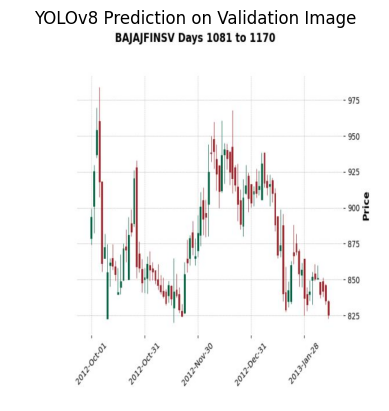

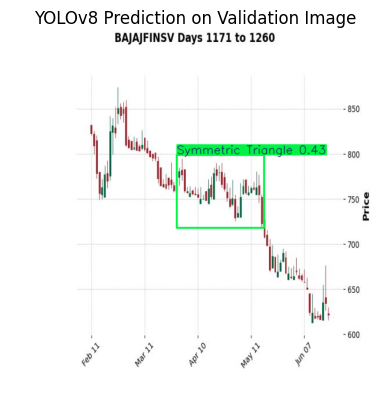

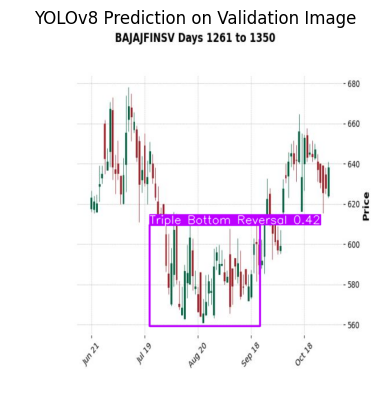

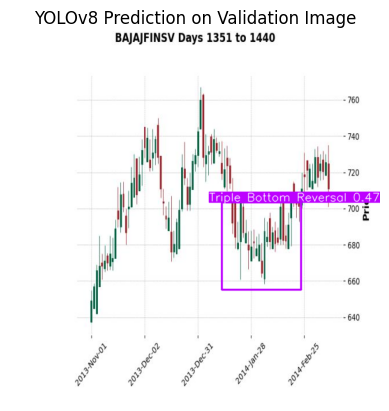

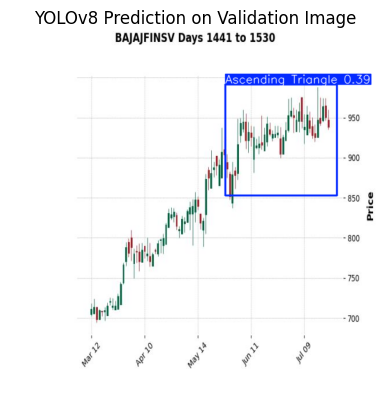

...

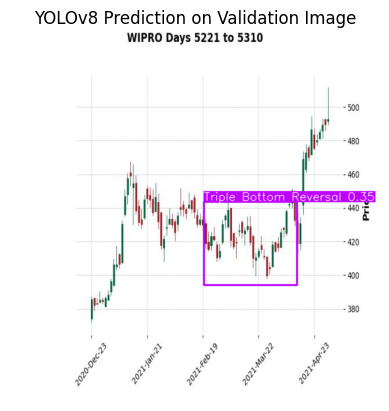

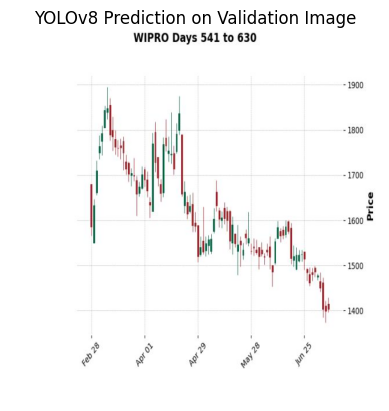

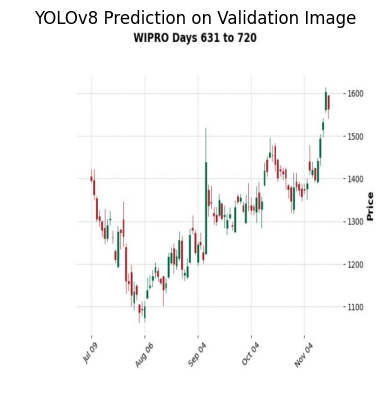

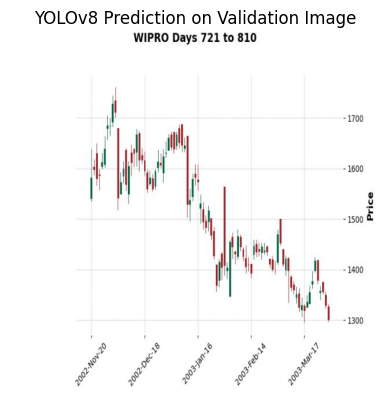

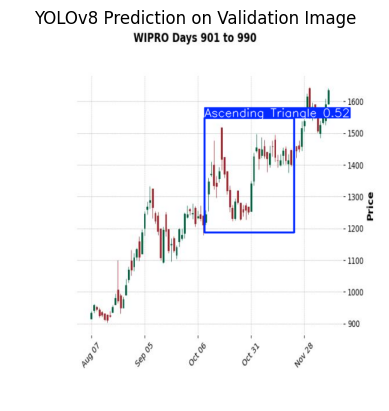

Predictions saved to runs/detect/predict


In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO
import torch

# Step 1: Training the YOLOv8 Model
def train_yolov8(data_yaml, model_save_path, epochs=100, img_size=640):
    """
    Train a YOLOv8 model on a custom dataset.

    Args:
        data_yaml (str): Path to the data.yaml file specifying dataset paths and classes.
        model_save_path (str): Path to save the trained model.
        epochs (int): Number of training epochs. Default is 50.
        img_size (int): Image size for training (height and width). Default is 640.

    Returns:
        model: Trained YOLOv8 model.
    """
    model = YOLO("yolov8m.pt")

    # Train the model
    try:
        model.train(
            data=data_yaml,
            epochs=epochs,
            imgsz=img_size,
            device="cuda" if torch.cuda.is_available() else "cpu",
            batch=16,
            workers=4,
            project="runs/train",
            name="exp"
        )
        model.save(model_save_path)
        print(f"Model saved to {model_save_path}")
        return model
    except Exception as e:
        print(f"Error during training: {e}")
        return None

# Step 2: Inference with the Trained YOLOv8 Model
def predict_yolov8(model_path, val_images_dir, output_dir="runs/detect/predict", conf=0.25, iou=0.45):
    """
    Perform inference on validation images using a trained YOLOv8 model.

    Args:
        model_path (str): Path to the trained YOLOv8 model (e.g., 'yolov8_model.pt').
        val_images_dir (str): Directory containing validation images.
        output_dir (str): Directory to save prediction results. Default is 'runs/detect/predict'.
        conf (float): Confidence threshold for predictions. Default is 0.25.
        iou (float): IoU threshold for Non-Maximum Suppression. Default is 0.45.

    Returns:
        results: YOLOv8 prediction results.
    """
    if not os.path.exists(val_images_dir) or not os.listdir(val_images_dir):
        print(f"Error: Validation images directory '{val_images_dir}' is empty or does not exist.")
        return None

    try:
        model = YOLO(model_path)
    except Exception as e:
        print(f"Error loading YOLOv8 model: {e}")
        return None

    try:
        results = model.predict(
            source=val_images_dir,
            conf=conf,
            iou=iou,
            save=True,
            save_txt=True,
            project=output_dir,
            name="exp"
        )

        # Visualize the results
        for result in results:
            annotated_image = result.plot()
            plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
            plt.axis("off")
            plt.title("YOLOv8 Prediction on Validation Image")
            plt.show()

        print(f"Predictions saved to {output_dir}")
        return results
    except Exception as e:
        print(f"Error during prediction: {e}")
        return None

# Main function to run training and inference
def run_yolov8_pipeline(dataset_dir="dataset", model_save_path="yolov8_trained_baseline-2.pt"):
    """
    Run the YOLOv8 training and inference pipeline using validation images.

    Args:
        dataset_dir (str): Directory containing the dataset (train and val folders).
        model_save_path (str): Path to save the trained model.
    """
    data_yaml = os.path.join(dataset_dir, "data.yaml")
    if not os.path.exists(data_yaml):
        print(f"Error: data.yaml not found in {dataset_dir}")
        return

    # Step 1: Train the model
    trained_model = train_yolov8(data_yaml, model_save_path, epochs=100, img_size=640)

    # Step 2: Perform inference on the validation set
    val_images_dir = os.path.join(dataset_dir, "valid", "images")
    if os.path.exists(val_images_dir):
        predict_yolov8(model_save_path, val_images_dir, conf=0.25, iou=0.45)
    else:
        print("Validation images directory not found. Skipping inference.")

# Run the pipeline
if __name__ == "__main__":
    dataset_dir = "/content/drive/MyDrive/dataset_yolo"  # Adjust this to your dataset path
    model_save_path = "/content/drive/MyDrive/yolov8_trained_baseline-2.pt"
    run_yolov8_pipeline(dataset_dir, model_save_path)

Using existing predictions in runs/detect/predict/exp/labels


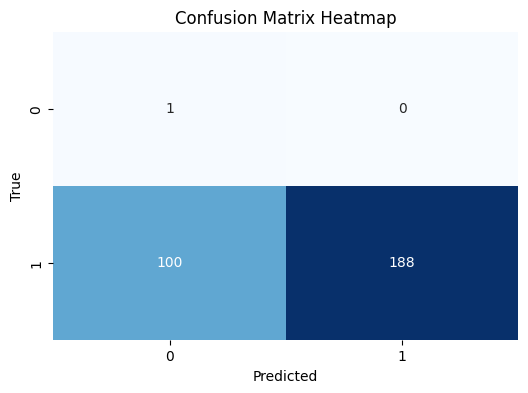

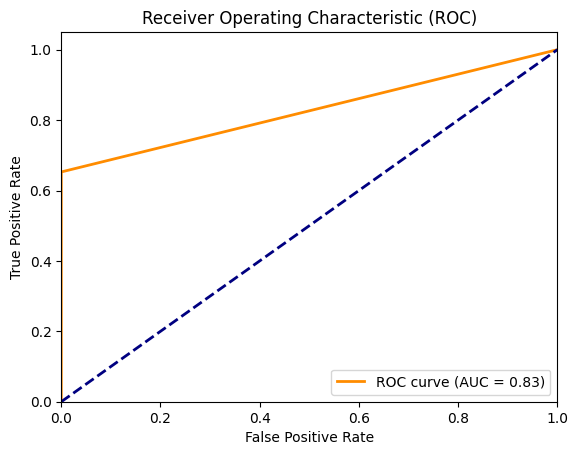

Metrics: {'accuracy': 0.6539792387543253, 'precision': 1.0, 'recall': 0.6527777777777778, 'f1_score': 0.7899159663865546, 'auc': np.float64(0.8263888888888888)}


In [ ]:
import os
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns
from ultralytics import YOLO

# Paths from your setup
MODEL_PATH = "/content/drive/MyDrive/yolov8_trained_baseline-2.pt"
VAL_IMAGES_DIR = "/content/drive/MyDrive/dataset_yolo/valid/images"
VAL_LABELS_DIR = "/content/drive/MyDrive/dataset_yolo/valid/labels"
PRED_DIR = "runs/detect/predict/exp/labels"  # Default prediction output from your original code

def generate_predictions_if_needed(model_path, val_images_dir, pred_dir, conf=0.5, iou=0.45):
    """
    Generate predictions if they don’t already exist.
    """
    if not os.path.exists(pred_dir) or not os.listdir(pred_dir):
        print(f"Prediction directory '{pred_dir}' is empty or does not exist. Generating predictions...")
        model = YOLO(model_path)
        model.predict(
            source=val_images_dir,
            conf=conf,
            iou=iou,
            save=True,
            save_txt=True,
            project="runs/detect/predict",
            name="exp"
        )
        print(f"Predictions saved to {pred_dir}")
    else:
        print(f"Using existing predictions in {pred_dir}")

def calculate_metrics(pred_dir, val_labels_dir):
    """
    Calculate evaluation metrics based on YOLOv8 predictions and ground truth labels.

    Args:
        pred_dir (str): Directory with prediction .txt files.
        val_labels_dir (str): Directory with ground truth .txt files.

    Returns:
        dict: Calculated metrics.
    """
    # Ensure predictions exist
    generate_predictions_if_needed(MODEL_PATH, VAL_IMAGES_DIR, pred_dir)

    # Lists to store ground truth and predictions
    y_true = []  # Ground truth labels (0: no object, 1: object)
    y_pred = []  # Predicted labels (0: no object, 1: object)
    y_scores = []  # Confidence scores for ROC/AUC

    # Get all ground truth files
    gt_files = {f.split(".txt")[0] for f in os.listdir(val_labels_dir) if f.endswith(".txt")}
    pred_files = {f.split(".txt")[0] for f in os.listdir(pred_dir) if f.endswith(".txt")} if os.path.exists(pred_dir) else set()

    # Process each validation image
    for img_name in gt_files:
        gt_path = os.path.join(val_labels_dir, f"{img_name}.txt")
        pred_path = os.path.join(pred_dir, f"{img_name}.txt") if img_name in pred_files else None

        # Ground truth: 1 if any object exists, 0 if none
        with open(gt_path, "r") as f:
            gt_lines = f.readlines()
            y_true.append(1 if len(gt_lines) > 0 else 0)

        # Prediction: 1 if any object detected, 0 if none
        if pred_path and os.path.exists(pred_path):
            with open(pred_path, "r") as f:
                pred_lines = f.readlines()
                if len(pred_lines) > 0:
                    y_pred.append(1)
                    # Use the highest confidence score for ROC
                    scores = [float(line.split()[5]) for line in pred_lines if len(line.split()) > 5]
                    y_scores.append(max(scores) if scores else 0.5)  # Default conf if no score
                else:
                    y_pred.append(0)
                    y_scores.append(0.0)
        else:
            y_pred.append(0)
            y_scores.append(0.0)

    # Ensure lengths match
    if len(y_true) != len(y_pred):
        print(f"Warning: Mismatch between ground truth ({len(y_true)}) and predictions ({len(y_pred)}). Truncating.")
        min_len = min(len(y_true), len(y_pred))
        y_true = y_true[:min_len]
        y_pred = y_pred[:min_len]
        y_scores = y_scores[:min_len]

    # Calculate metrics
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)

    # Confusion Matrix and Heatmap
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False)
    plt.title("Confusion Matrix Heatmap")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()

    # ROC and AUC
    fpr, tpr, _ = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)
    plt.figure()
    plt.plot(fpr, tpr, color="darkorange", lw=2, label=f"ROC curve (AUC = {roc_auc:.2f})")
    plt.plot([0, 1], [0, 1], color="navy", lw=2, linestyle="--")
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("Receiver Operating Characteristic (ROC)")
    plt.legend(loc="lower right")
    plt.show()

    # Compile metrics
    metrics = {
        "accuracy": accuracy,
        "precision": precision,
        "recall": recall,
        "f1_score": f1,
        "auc": roc_auc
    }
    print(f"Metrics: {metrics}")
    return metrics

# Run the metrics calculation
if __name__ == "__main__":
    if not os.path.exists(VAL_LABELS_DIR):
        print(f"Error: Validation labels directory '{VAL_LABELS_DIR}' not found.")
    elif not os.path.exists(MODEL_PATH):
        print(f"Error: Model file '{MODEL_PATH}' not found.")
    else:
        calculate_metrics(PRED_DIR, VAL_LABELS_DIR)

from sklearn.metrics import classification_report, confusion_matrix

def get_multiclass_metrics(pred_dir, val_labels_dir, class_names):
    """
    Compute per-class confusion matrix and classification report.
    Assumes YOLO format: class_id x_center y_center width height [conf]
    """
    generate_predictions_if_needed(MODEL_PATH, VAL_IMAGES_DIR, pred_dir)

    y_true = []
    y_pred = []

    gt_files = {f.split(".txt")[0] for f in os.listdir(val_labels_dir) if f.endswith(".txt")}
    pred_files = {f.split(".txt")[0] for f in os.listdir(pred_dir) if f.endswith(".txt")}

    for img_name in gt_files:
        gt_path = os.path.join(val_labels_dir, f"{img_name}.txt")
        pred_path = os.path.join(pred_dir, f"{img_name}.txt")

        # Extract ground truth labels
        gt_labels = []
        if os.path.exists(gt_path):
            with open(gt_path, "r") as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) >= 1:
                        gt_labels.append(int(parts[0]))

        # Extract predicted labels
        pred_labels = []
        if os.path.exists(pred_path):
            with open(pred_path, "r") as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) >= 1:
                        pred_labels.append(int(parts[0]))

        # Compare predictions and ground truths (match number of predictions to GTs)
        y_true.extend(gt_labels)
        y_pred.extend(pred_labels if pred_labels else [-1] * len(gt_labels))  # -1 for missed predictions

    # Filter out invalid predictions
    valid_classes = list(range(len(class_names)))
    y_true_filtered = [yt for yt in y_true if yt in valid_classes]
    y_pred_filtered = [yp if yp in valid_classes else -1 for yp in y_pred[:len(y_true_filtered)]]

    # Classification report and confusion matrix
    print("\nClassification Report (Per Class):\n")
    print(classification_report(y_true_filtered, y_pred_filtered, target_names=class_names, digits=3, zero_division=0))

    cm = confusion_matrix(y_true_filtered, y_pred_filtered, labels=valid_classes)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.title("Confusion Matrix (Per Class)")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

Using existing predictions in runs/detect/predict/exp/labels

Classification Report (Per Class):

                           precision    recall  f1-score   support

       Ascending Triangle      0.000     0.000     0.000         0
           Cup and Handle      0.333     0.162     0.218        68
      Descending Triangle      0.000     0.000     0.000         6
            Double Bottom      0.222     0.065     0.100        31
               Double Top      0.000     0.000     0.000        12
        Head and Shoulder      0.125     0.043     0.065        23
Inverse Head and Shoulder      0.000     0.000     0.000        17
       Symmetric Triangle      0.000     0.000     0.000        14
            Falling wedge      0.125     0.029     0.047        35
   Triple Bottom Reversal      0.323     0.273     0.296        77
            Flag-and-Pole      0.000     0.000     0.000         5

                 accuracy                          0.125       288
                macro avg    

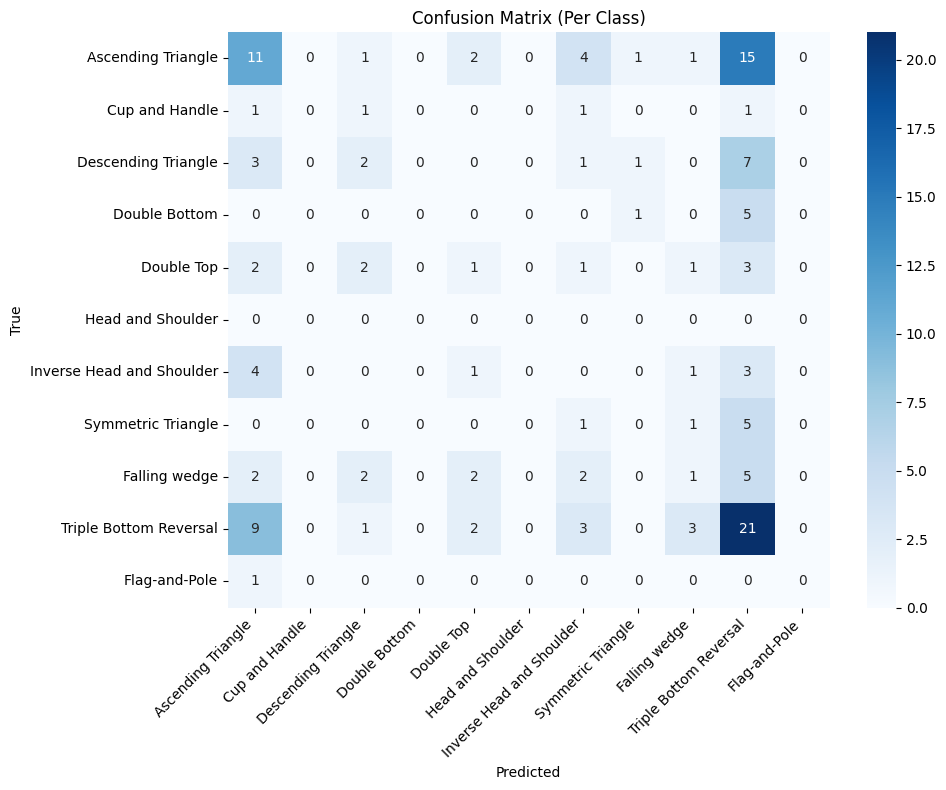

In [ ]:
class_names = [
    "Ascending Triangle",
    "Cup and Handle",
    "Descending Triangle",
    "Double Bottom",
    "Double Top",
    "Head and Shoulder",
    "Inverse Head and Shoulder",
    "Symmetric Triangle",
    "Falling wedge",
    "Triple Bottom Reversal",
    "Flag-and-Pole"
]

get_multiclass_metrics(pred_dir="runs/detect/predict/exp/labels",
                       val_labels_dir="/content/drive/MyDrive/dataset_yolo/valid/labels",
                       class_names=class_names)


In [ ]:
!pip install ultralyticsplus==0.0.28 ultralytics==8.0.43

  Attempting uninstall: ultralyticsplus
    Found existing installation: ultralyticsplus 0.1.0
    Uninstalling ultralyticsplus-0.1.0:
      Successfully uninstalled ultralyticsplus-0.1.0


In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO  # Using ultralytics
import torch
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

# Patch torch.load to use weights_only=False for trusted sources
original_torch_load = torch.load

def patched_torch_load(*args, **kwargs):
    kwargs['weights_only'] = False  # Force weights_only=False
    return original_torch_load(*args, **kwargs)

# Step 1: Training the YOLOv8 Model
def train_yolov8(data_yaml, model_save_path, epochs=100, img_size=640, model_path="/content/drive/MyDrive/best (1).pt"):
    # Check if the model file exists
    if not os.path.exists(model_path):
        raise FileNotFoundError(f"Model file not found at {model_path}. Ensure 'best (1).pt' is uploaded to Google Drive.")

    # Load the pre-trained model with patched torch.load
    torch.load = patched_torch_load
    try:
        model = YOLO(model_path)
    finally:
        torch.load = original_torch_load  # Restore original torch.load

    # Set model parameters as per Hugging Face example
    model.overrides['conf'] = 0.25  # NMS confidence threshold
    model.overrides['iou'] = 0.45  # NMS IoU threshold
    model.overrides['agnostic_nms'] = False  # NMS class-agnostic
    model.overrides['max_det'] = 1000  # Maximum detections per image

    # Train with custom settings
    try:
        model.train(
            data=data_yaml,
            epochs=epochs,
            imgsz=img_size,
            device="cuda" if torch.cuda.is_available() else "cpu",
            batch=16,
            workers=4,
            project="runs/train",
            name="exp",
            cls_pw=[0.0045] * 3 + [0.02] * 8,  # Weighted Cross-Entropy
            fl_gamma=2.0  # Focal Loss
        )
        model.save(model_save_path)
        print(f"Model saved to {model_save_path}")
        return model
    except Exception as e:
        print(f"Error during training: {e}")
        return None

# Step 2: Inference
def predict_yolov8(model_path, val_images_dir, output_dir="runs/detect/predict", conf=0.25, iou=0.45):
    if not os.path.exists(val_images_dir) or not os.listdir(val_images_dir):
        print(f"Error: Validation images directory '{val_images_dir}' is empty or does not exist.")
        return None

    # Load the saved model with patched torch.load
    torch.load = patched_torch_load
    try:
        model = YOLO(model_path)
    finally:
        torch.load = original_torch_load  # Restore original torch.load

    # Set model parameters
    model.overrides['conf'] = conf
    model.overrides['iou'] = iou
    model.overrides['agnostic_nms'] = False
    model.overrides['max_det'] = 1000

    try:
        results = model.predict(
            source=val_images_dir,
            conf=conf,
            iou=iou,
            save=True,
            save_txt=True,
            project=output_dir,
            name="exp"
        )
        for result in results:
            annotated_image = result.plot()
            plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
            plt.axis("off")
            plt.title("YOLOv8 Prediction on Validation Image")
            plt.show()
        print(f"Predictions saved to {output_dir}")
        return results
    except Exception as e:
        print(f"Error during prediction: {e}")
        return None

# Main Pipeline
def run_yolov8_pipeline(dataset_dir="dataset", model_save_path="yolov8_trained_baseline-2.pt", model_weights_path="/content/drive/MyDrive/best (1).pt"):
    data_yaml = os.path.join(dataset_dir, "data.yaml")
    if not os.path.exists(data_yaml):
        print(f"Error: data.yaml not found in {dataset_dir}")
        return

    trained_model = train_yolov8(data_yaml, model_save_path, epochs=100, img_size=640, model_path=model_weights_path)
    if trained_model:
        val_images_dir = os.path.join(dataset_dir, "valid", "images")
        if os.path.exists(val_images_dir):
            predict_yolov8(model_save_path, val_images_dir, conf=0.25, iou=0.45)
        else:
            print("Validation images directory not found. Skipping inference.")

if __name__ == "__main__":
    # Install ultralytics
    !pip install ultralytics==8.0.43

    dataset_dir = "/content/drive/MyDrive/dataset_yolo"
    model_save_path = "/content/drive/MyDrive/yolov8_trained_baseline-2.pt"
    model_weights_path = "/content/drive/MyDrive/best (1).pt"  # Matches your file
    run_yolov8_pipeline(dataset_dir, model_save_path, model_weights_path)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Error during training: 'cls_pw' is not a valid YOLO argument. Similar arguments are i.e. ['cls=0.5'].

    Arguments received: ['yolo', '-f', '/root/.local/share/jupyter/runtime/kernel-b47cedec-cf2c-4dcc-960b-83e9736cc1aa.json']. Note that Ultralytics 'yolo' commands use the following syntax:

        yolo TASK MODE ARGS

        Where   TASK (optional) is one of [detect, segment, classify]
                MODE (required) is one of [train, val, predict, export, track]
                ARGS (optional) are any number of custom 'arg=value' pairs like 'imgsz=320' that override defaults.
                    See all ARGS at https://docs.ultralytics.com/cfg or with 'yolo cfg'

    1. Train a detection model for 10 epochs with an initial learning_rate of 0.01
        yolo train data=coco128.yaml model=yolov8n.pt epochs=10 lr0=0.01

    2. Predict a YouTube video using

In [ ]:
import os
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, auc, classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from ultralyticsplus import YOLO

MODEL_PATH = "/content/drive/MyDrive/yolov8_trained_baseline.pt"
VAL_IMAGES_DIR = "/content/drive/MyDrive/dataset_yolo/valid/images"
VAL_LABELS_DIR = "/content/drive/MyDrive/dataset_yolo/valid/labels"
PRED_DIR = "runs/detect/predict/exp/labels"

def generate_predictions_if_needed(model_path, val_images_dir, pred_dir, conf=0.25, iou=0.45):
    if not os.path.exists(pred_dir) or not os.listdir(pred_dir):
        print(f"Generating predictions...")
        model = YOLO(model_path)
        model.predict(
            source=val_images_dir,
            conf=conf,
            iou=iou,
            save=True,
            save_txt=True,
            project="runs/detect/predict",
            name="exp"
        )
        print(f"Predictions saved to {pred_dir}")
    else:
        print(f"Using existing predictions in {pred_dir}")

def calculate_metrics(pred_dir, val_labels_dir):
    generate_predictions_if_needed(MODEL_PATH, VAL_IMAGES_DIR, pred_dir)
    y_true, y_pred, y_scores = [], [], []

    gt_files = {f.split(".txt")[0] for f in os.listdir(val_labels_dir) if f.endswith(".txt")}
    pred_files = {f.split(".txt")[0] for f in os.listdir(pred_dir) if f.endswith(".txt")} if os.path.exists(pred_dir) else set()

    for img_name in gt_files:
        gt_path = os.path.join(val_labels_dir, f"{img_name}.txt")
        pred_path = os.path.join(pred_dir, f"{img_name}.txt") if img_name in pred_files else None

        with open(gt_path, "r") as f:
            gt_lines = f.readlines()
            y_true.append(1 if len(gt_lines) > 0 else 0)

        if pred_path and os.path.exists(pred_path):
            with open(pred_path, "r") as f:
                pred_lines = f.readlines()
                if len(pred_lines) > 0:
                    y_pred.append(1)
                    scores = [float(line.split()[5]) for line in pred_lines if len(line.split()) > 5]
                    y_scores.append(max(scores) if scores else 0.5)
                else:
                    y_pred.append(0)
                    y_scores.append(0.0)
        else:
            y_pred.append(0)
            y_scores.append(0.0)

    min_len = min(len(y_true), len(y_pred))
    y_true, y_pred, y_scores = y_true[:min_len], y_pred[:min_len], y_scores[:min_len]

    metrics = {
        "accuracy": accuracy_score(y_true, y_pred),
        "precision": precision_score(y_true, y_pred, zero_division=0),
        "recall": recall_score(y_true, y_pred, zero_division=0),
        "f1_score": f1_score(y_true, y_pred, zero_division=0),
        "auc": auc(*roc_curve(y_true, y_scores)[:2])
    }

    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()

    plt.figure()
    fpr, tpr, _ = roc_curve(y_true, y_scores)
    plt.plot(fpr, tpr, color="darkorange", lw=2, label=f"ROC curve (AUC = {metrics['auc']:.2f})")
    plt.plot([0, 1], [0, 1], color="navy", lw=2, linestyle="--")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curve")
    plt.legend(loc="lower right")
    plt.show()

    print(f"Metrics: {metrics}")
    return metrics

def get_multiclass_metrics(pred_dir, val_labels_dir, class_names):
    generate_predictions_if_needed(MODEL_PATH, VAL_IMAGES_DIR, pred_dir)
    y_true, y_pred = [], []

    gt_files = {f.split(".txt")[0] for f in os.listdir(val_labels_dir) if f.endswith(".txt")}
    pred_files = {f.split(".txt")[0] for f in os.listdir(pred_dir) if f.endswith(".txt")}

    for img_name in gt_files:
        gt_path = os.path.join(val_labels_dir, f"{img_name}.txt")
        pred_path = os.path.join(pred_dir, f"{img_name}.txt")

        gt_labels = [int(line.strip().split()[0]) for line in open(gt_path, "r") if line.strip()]
        pred_labels = [int(line.strip().split()[0]) for line in open(pred_path, "r") if line.strip()] if os.path.exists(pred_path) else []

        y_true.extend(gt_labels)
        y_pred.extend(pred_labels if pred_labels else [-1] * len(gt_labels))

    valid_classes = list(range(len(class_names)))
    y_true_filtered = [yt for yt in y_true if yt in valid_classes]
    y_pred_filtered = [yp if yp in valid_classes else -1 for yp in y_pred[:len(y_true_filtered)]]

    print("\nClassification Report (Per Class):\n")
    print(classification_report(y_true_filtered, y_pred_filtered, target_names=class_names, digits=3, zero_division=0))

    cm = confusion_matrix(y_true_filtered, y_pred_filtered, labels=valid_classes)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.title("Confusion Matrix (Per Class)")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    yaml_path = "/content/drive/MyDrive/dataset_yolo/data.yaml"
    data_config = load_data_yaml(yaml_path)
    class_names = data_config['names']  # Extract class names from your data.yaml

    if os.path.exists(VAL_LABELS_DIR) and os.path.exists(MODEL_PATH):
        calculate_metrics(PRED_DIR, VAL_LABELS_DIR)
        get_multiclass_metrics(PRED_DIR, VAL_LABELS_DIR, class_names)
    else:
        print("Required directories or model file not found.")

ModuleNotFoundError: No module named 'ultralyticsplus'

### Focal loss

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


best.pt:   0%|          | 0.00/134M [00:00<?, ?B/s]

Pre-trained model downloaded to: /root/.cache/huggingface/hub/models--foduucom--stockmarket-pattern-detection-yolov8/snapshots/9634a9d9d8c30cba10313c3a8c310814490c3d0b/best.pt
Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=/root/.cache/huggingface/hub/models--foduucom--stockmarket-pattern-detection-yolov8/snapshots/9634a9d9d8c30cba10313c3a8c310814490c3d0b/best.pt, data=/content/drive/MyDrive/dataset_yolo/data.yaml, epochs=150, time=None, patience=0, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=runs/train, name=exp_transfer_learning_focal_tuned, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False

100%|██████████| 755k/755k [00:00<00:00, 19.6MB/s]


Overriding model.yaml nc=6 with nc=11

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 84.9MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/dataset_yolo/train/labels.cache... 1176 images, 6 backgrounds, 0 corrupt: 100%|██████████| 1176/1176 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/dataset_yolo/valid/labels.cache... 289 images, 1 backgrounds, 0 corrupt: 100%|██████████| 289/289 [00:00<?, ?it/s]


Plotting labels to runs/train/exp_transfer_learning_focal_tuned/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/train/exp_transfer_learning_focal_tuned
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      3.77G      1.927      10.59      2.214         11        640: 100%|██████████| 74/74 [03:16<00:00,  2.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.20it/s]

                   all        289        288      0.528     0.0418    0.00652    0.00188



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      4.57G      1.764      8.522      2.084         15        640: 100%|██████████| 74/74 [00:27<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.87it/s]

                   all        289        288       0.75     0.0223     0.0353     0.0101



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      4.61G      1.779      7.202      2.101         19        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.21it/s]


                   all        289        288     0.0202      0.659     0.0496     0.0163

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      4.64G      1.768      6.481      2.084         14        640: 100%|██████████| 74/74 [00:25<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.35it/s]

                   all        289        288      0.741     0.0579     0.0691     0.0251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      4.64G       1.76      6.262      2.087          9        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.80it/s]

                   all        289        288      0.525      0.214      0.115     0.0482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      4.64G      1.749      6.108      2.058         14        640: 100%|██████████| 74/74 [00:27<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.77it/s]

                   all        289        288      0.498      0.151      0.101     0.0386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      4.64G      1.751      6.067      2.067         13        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.33it/s]

                   all        289        288      0.611      0.187       0.12     0.0512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      4.68G      1.716      5.878      2.019         19        640: 100%|██████████| 74/74 [00:25<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.03it/s]

                   all        289        288      0.516      0.227      0.136     0.0653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      4.72G      1.733      5.814      2.027         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.81it/s]

                   all        289        288      0.499      0.185      0.135     0.0569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      4.75G      1.711      5.785      2.014         19        640: 100%|██████████| 74/74 [00:26<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.71it/s]

                   all        289        288      0.504       0.21      0.143     0.0605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      4.75G      1.715      5.746      2.023         17        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.65it/s]


                   all        289        288      0.424      0.185      0.125     0.0538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      4.75G      1.726      5.741      2.027         18        640: 100%|██████████| 74/74 [00:25<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.07it/s]

                   all        289        288      0.325      0.214      0.141     0.0656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      4.75G      1.733      5.685      2.022         15        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.74it/s]

                   all        289        288      0.309      0.222      0.146     0.0589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      4.75G      1.733      5.564      2.003         17        640: 100%|██████████| 74/74 [00:27<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.76it/s]

                   all        289        288      0.436        0.2      0.159     0.0696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      4.75G      1.724      5.645      2.022         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]


                   all        289        288      0.441      0.213       0.14     0.0608

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      4.75G      1.699      5.583      2.002         10        640: 100%|██████████| 74/74 [00:26<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.03it/s]

                   all        289        288      0.216      0.186      0.145     0.0629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      4.75G        1.7       5.49      1.988         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.79it/s]

                   all        289        288      0.332      0.231      0.145     0.0622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      4.75G      1.746       5.54      2.042         11        640: 100%|██████████| 74/74 [00:27<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.79it/s]

                   all        289        288      0.343      0.237      0.156     0.0698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      4.75G      1.699      5.414          2         15        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.58it/s]


                   all        289        288      0.428      0.223      0.155     0.0723

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      4.75G      1.727      5.498      2.011         13        640: 100%|██████████| 74/74 [00:26<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.97it/s]

                   all        289        288      0.236      0.241      0.164      0.077



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      4.75G      1.706        5.5      1.996         18        640: 100%|██████████| 74/74 [00:26<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.68it/s]

                   all        289        288      0.362      0.247      0.156     0.0681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      4.75G      1.695      5.497      2.001         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.63it/s]

                   all        289        288      0.358      0.241      0.153     0.0671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      4.75G      1.695      5.445      2.013         11        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.71it/s]

                   all        289        288      0.313      0.186      0.121     0.0524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      4.75G      1.715      5.406      2.011         11        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.10it/s]

                   all        289        288      0.149      0.245      0.163     0.0793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      4.75G      1.685      5.383      1.989         20        640: 100%|██████████| 74/74 [00:26<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.57it/s]

                   all        289        288      0.328      0.205       0.14     0.0598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      4.75G      1.694      5.421       1.99         13        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.86it/s]

                   all        289        288      0.478      0.226      0.148     0.0621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      4.75G      1.705      5.322       2.01         15        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.70it/s]

                   all        289        288      0.239      0.221      0.142     0.0592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      4.75G      1.683      5.296      1.994          9        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.10it/s]


                   all        289        288      0.257      0.236      0.155     0.0675

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      4.75G       1.67      5.317      1.973         15        640: 100%|██████████| 74/74 [00:25<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.23it/s]

                   all        289        288      0.367       0.26      0.174     0.0799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      4.75G      1.692      5.305      1.984         10        640: 100%|██████████| 74/74 [00:27<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.90it/s]

                   all        289        288      0.322       0.23      0.161     0.0695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      4.75G       1.66      5.276      1.979         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.86it/s]

                   all        289        288      0.339      0.268      0.161     0.0704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      4.78G      1.682      5.268      1.973         13        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.245      0.208      0.135     0.0603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      4.82G      1.679      5.345      1.995         12        640: 100%|██████████| 74/74 [00:25<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.06it/s]

                   all        289        288      0.246       0.22      0.171     0.0703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      4.82G       1.67       5.19      1.957         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.71it/s]

                   all        289        288      0.389       0.27      0.192      0.089



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      4.82G      1.666      5.193      1.971         10        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.88it/s]

                   all        289        288      0.491      0.217      0.179     0.0809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      4.82G      1.665      5.239       1.99         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.87it/s]

                   all        289        288      0.256      0.269      0.163     0.0713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      4.82G      1.667        5.2      1.962         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.09it/s]

                   all        289        288      0.399      0.241      0.192     0.0856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      4.82G      1.647      5.104      1.965         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.70it/s]

                   all        289        288      0.265      0.234      0.179     0.0788



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      4.82G      1.666      5.211      1.993         11        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.168      0.288      0.189     0.0814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      4.82G      1.669      5.222      1.984         13        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.53it/s]


                   all        289        288      0.392      0.247      0.174     0.0784

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      4.82G      1.667      5.226      1.972         17        640: 100%|██████████| 74/74 [00:26<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  2.00it/s]

                   all        289        288      0.214      0.179      0.151     0.0628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      4.82G      1.662       5.19      1.971         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.81it/s]

                   all        289        288      0.245      0.259      0.153     0.0659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      4.82G      1.649      5.155      1.967         13        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.65it/s]

                   all        289        288      0.365      0.222      0.181     0.0771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      4.82G      1.658       5.12      1.962         18        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.46it/s]

                   all        289        288      0.332      0.231      0.142     0.0569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      4.82G      1.655      5.048       1.96         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.09it/s]

                   all        289        288      0.474      0.215      0.179     0.0813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      4.82G      1.636      5.152      1.954         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.82it/s]

                   all        289        288       0.27      0.273      0.176     0.0765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      4.82G      1.653      5.074      1.943         11        640: 100%|██████████| 74/74 [00:26<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.85it/s]

                   all        289        288      0.276      0.294      0.175     0.0782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      4.82G      1.675      5.124      1.976         13        640: 100%|██████████| 74/74 [00:26<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.47it/s]

                   all        289        288      0.377      0.279      0.178     0.0811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      4.82G      1.641      5.152      1.942         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.20it/s]

                   all        289        288      0.264      0.233      0.173      0.077



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      4.82G      1.647      5.083      1.941         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.81it/s]

                   all        289        288       0.29      0.203      0.188      0.086



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      4.82G      1.656       5.04       1.96         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.92it/s]

                   all        289        288      0.395      0.246      0.206     0.0919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      4.82G      1.625      4.952      1.935         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.521       0.18      0.196     0.0898



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      4.83G       1.64      4.975      1.945         18        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  2.00it/s]

                   all        289        288      0.381      0.257      0.204     0.0943



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      4.86G      1.662      5.056       1.97         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.69it/s]

                   all        289        288      0.381      0.262      0.192     0.0858



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      4.86G      1.623      4.951      1.953         24        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.77it/s]

                   all        289        288      0.154      0.259      0.164     0.0697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      4.86G      1.639      4.974       1.96         16        640: 100%|██████████| 74/74 [00:27<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.92it/s]

                   all        289        288      0.141      0.246      0.162     0.0672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      4.86G      1.623      4.957      1.937         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.13it/s]

                   all        289        288      0.375      0.253      0.175     0.0722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      4.86G      1.643      4.958      1.955         11        640: 100%|██████████| 74/74 [00:26<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.56it/s]

                   all        289        288      0.366      0.272      0.183     0.0761



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      4.86G      1.634      5.061      1.937         11        640: 100%|██████████| 74/74 [00:26<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.71it/s]

                   all        289        288      0.252      0.229       0.16     0.0673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      4.86G      1.637      5.016       1.94         11        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.82it/s]

                   all        289        288       0.17      0.257      0.159     0.0714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      4.86G      1.627      4.985       1.93         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.44it/s]

                   all        289        288      0.244      0.237      0.163     0.0701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      4.86G      1.629      4.919       1.92         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.44it/s]

                   all        289        288      0.269      0.298       0.17     0.0748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      4.86G      1.649       4.99      1.952         15        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.172      0.243       0.19      0.085



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      4.86G      1.627       4.95      1.919         19        640: 100%|██████████| 74/74 [00:27<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.77it/s]

                   all        289        288      0.243      0.289      0.162     0.0732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      4.86G      1.616      4.946      1.949         18        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.01it/s]


                   all        289        288      0.158      0.243      0.188     0.0849

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      4.86G      1.618      4.936      1.933         11        640: 100%|██████████| 74/74 [00:26<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.44it/s]

                   all        289        288      0.265      0.258      0.178     0.0732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      4.86G       1.62      4.913      1.923         10        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.66it/s]

                   all        289        288      0.155      0.248      0.198     0.0878



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      4.86G      1.598      4.935      1.908         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.87it/s]

                   all        289        288      0.267      0.253      0.176     0.0799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      4.86G      1.596      4.931      1.912         10        640: 100%|██████████| 74/74 [00:26<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.04it/s]

                   all        289        288      0.149      0.271      0.171     0.0751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      4.86G      1.616      4.888      1.944         11        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.58it/s]

                   all        289        288      0.247      0.278      0.166      0.074



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      4.86G      1.624      4.855      1.929         13        640: 100%|██████████| 74/74 [00:27<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.77it/s]

                   all        289        288      0.153      0.287      0.177      0.078



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      4.86G        1.6      4.759      1.911         17        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.89it/s]

                   all        289        288      0.169       0.26       0.18     0.0773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      4.86G      1.607      4.798      1.927         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.15it/s]


                   all        289        288      0.145      0.283      0.163     0.0723

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      4.86G      1.622       4.89      1.931          9        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.51it/s]

                   all        289        288      0.239      0.271      0.163     0.0677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      4.86G      1.597       4.81      1.914         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.78it/s]

                   all        289        288      0.144      0.298      0.176     0.0749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      4.86G      1.614      4.802      1.935         21        640: 100%|██████████| 74/74 [00:26<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.78it/s]

                   all        289        288      0.135      0.294      0.172     0.0736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      4.86G      1.603      4.774      1.929         15        640: 100%|██████████| 74/74 [00:26<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.23it/s]

                   all        289        288      0.141      0.243       0.17     0.0749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      4.86G      1.607      4.858      1.914         15        640: 100%|██████████| 74/74 [00:26<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.57it/s]

                   all        289        288      0.276       0.27      0.179     0.0771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      4.86G      1.611      4.763      1.929         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.86it/s]

                   all        289        288      0.264      0.272      0.205     0.0899



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      4.86G      1.593      4.677      1.915         15        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.75it/s]

                   all        289        288      0.277      0.289       0.19     0.0813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      4.86G      1.604        4.8       1.92         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.14it/s]

                   all        289        288      0.158      0.268      0.172     0.0735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      4.86G      1.582      4.749      1.901         10        640: 100%|██████████| 74/74 [00:26<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]

                   all        289        288      0.343      0.291      0.179     0.0791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      4.86G      1.613      4.789      1.937         21        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.88it/s]

                   all        289        288      0.142      0.306      0.172      0.075



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      4.86G      1.587      4.692      1.903         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  3.01it/s]

                   all        289        288      0.147      0.288       0.18     0.0773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      4.86G      1.586       4.78      1.909         15        640: 100%|██████████| 74/74 [00:27<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.13it/s]


                   all        289        288      0.144      0.294      0.172     0.0752

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      4.86G      1.602      4.732      1.907         21        640: 100%|██████████| 74/74 [00:25<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.32it/s]

                   all        289        288      0.161      0.317       0.19      0.078



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      4.86G      1.578      4.721      1.892         13        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.82it/s]

                   all        289        288      0.138      0.273      0.183     0.0788



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150      4.86G      1.593      4.643      1.897         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.70it/s]

                   all        289        288      0.138      0.286      0.188     0.0831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      4.86G      1.579      4.651      1.902         12        640: 100%|██████████| 74/74 [00:27<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.19it/s]

                   all        289        288      0.138       0.31      0.173     0.0742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      4.86G      1.571      4.663      1.901         18        640: 100%|██████████| 74/74 [00:27<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.45it/s]

                   all        289        288       0.14      0.271      0.164     0.0696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      4.86G      1.611       4.58      1.915         18        640: 100%|██████████| 74/74 [00:28<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.157      0.268      0.173     0.0782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      4.86G      1.602      4.714       1.91         14        640: 100%|██████████| 74/74 [00:28<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.23it/s]


                   all        289        288      0.163      0.273      0.189     0.0851

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      4.86G      1.591      4.701      1.925         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]

                   all        289        288       0.15       0.31      0.185     0.0758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      4.86G        1.6      4.688      1.926         13        640: 100%|██████████| 74/74 [00:27<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.162      0.285      0.184     0.0808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      4.86G      1.574      4.676      1.898         17        640: 100%|██████████| 74/74 [00:26<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.79it/s]

                   all        289        288      0.146      0.294      0.176     0.0718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      4.86G      1.579      4.569      1.906         16        640: 100%|██████████| 74/74 [00:27<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.06it/s]

                   all        289        288      0.144      0.294       0.18     0.0764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150      4.86G      1.595       4.71      1.926         13        640: 100%|██████████| 74/74 [00:27<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.71it/s]

                   all        289        288      0.145      0.292      0.178      0.073



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      4.86G      1.576      4.668      1.875         10        640: 100%|██████████| 74/74 [00:27<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.158      0.286      0.181      0.076



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      4.86G      1.567      4.565      1.885         19        640: 100%|██████████| 74/74 [00:27<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.77it/s]

                   all        289        288      0.148      0.281      0.176      0.075



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      4.86G      1.573      4.593      1.901         16        640: 100%|██████████| 74/74 [00:27<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.06it/s]

                   all        289        288       0.14      0.323      0.179     0.0792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      4.86G      1.575      4.585      1.899         15        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.74it/s]

                   all        289        288      0.162      0.316      0.189     0.0784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      4.86G      1.563       4.56      1.879         19        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.80it/s]

                   all        289        288      0.252      0.265      0.178     0.0748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      4.86G      1.555      4.577      1.882         13        640: 100%|██████████| 74/74 [00:27<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.156      0.309      0.177     0.0727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      4.86G      1.556      4.521      1.889         14        640: 100%|██████████| 74/74 [00:26<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.16it/s]

                   all        289        288      0.375      0.272      0.175     0.0735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      4.86G      1.552      4.611        1.9         12        640: 100%|██████████| 74/74 [00:26<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.76it/s]

                   all        289        288      0.152      0.303      0.166     0.0686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      4.86G      1.567      4.565      1.887         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.68it/s]

                   all        289        288      0.133      0.281       0.17      0.073



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      4.86G       1.55       4.48      1.881         16        640: 100%|██████████| 74/74 [00:26<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.49it/s]


                   all        289        288      0.148      0.293      0.181     0.0752

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      4.86G      1.561      4.526      1.882         18        640: 100%|██████████| 74/74 [00:26<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.30it/s]

                   all        289        288       0.14      0.301      0.167     0.0717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      4.86G       1.58      4.561      1.902         13        640: 100%|██████████| 74/74 [00:26<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.74it/s]

                   all        289        288      0.139      0.321      0.166     0.0715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      4.86G      1.566      4.543      1.889         17        640: 100%|██████████| 74/74 [00:27<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.75it/s]

                   all        289        288      0.267      0.287      0.164     0.0674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      4.86G      1.558      4.477      1.883         13        640: 100%|██████████| 74/74 [00:27<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.98it/s]


                   all        289        288      0.142      0.302      0.165     0.0679

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      4.86G      1.553       4.49      1.886         14        640: 100%|██████████| 74/74 [00:28<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.65it/s]

                   all        289        288      0.135      0.304       0.16     0.0663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      4.86G      1.554      4.486      1.873         15        640: 100%|██████████| 74/74 [00:27<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.57it/s]

                   all        289        288      0.145      0.301      0.177     0.0744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      4.86G      1.531      4.537      1.861         10        640: 100%|██████████| 74/74 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.11it/s]


                   all        289        288      0.154      0.298      0.183     0.0736

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      4.86G      1.583      4.495      1.915         11        640: 100%|██████████| 74/74 [00:27<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.151      0.311      0.169     0.0713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      4.86G      1.541      4.464      1.874         14        640: 100%|██████████| 74/74 [00:27<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.142      0.286      0.159     0.0661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      4.86G      1.572      4.551      1.892         14        640: 100%|██████████| 74/74 [00:27<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.155      0.259      0.164     0.0682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      4.86G      1.554      4.348      1.885         19        640: 100%|██████████| 74/74 [00:27<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.40it/s]

                   all        289        288      0.139       0.29      0.165     0.0682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      4.86G      1.564      4.531        1.9         13        640: 100%|██████████| 74/74 [00:27<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.65it/s]

                   all        289        288      0.156      0.333      0.162     0.0683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      4.86G       1.54      4.409      1.858         15        640: 100%|██████████| 74/74 [00:27<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.10it/s]


                   all        289        288      0.176      0.272      0.171      0.072

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      4.86G      1.537      4.386      1.865         15        640: 100%|██████████| 74/74 [00:27<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.30it/s]

                   all        289        288      0.148      0.257      0.159     0.0677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      4.86G      1.564      4.462      1.889         23        640: 100%|██████████| 74/74 [00:28<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.76it/s]

                   all        289        288      0.162       0.28      0.168     0.0715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      4.86G      1.547      4.376      1.861         13        640: 100%|██████████| 74/74 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.148      0.303      0.154     0.0648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      4.86G      1.555      4.404      1.894         16        640: 100%|██████████| 74/74 [00:27<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.17it/s]

                   all        289        288      0.149      0.306      0.171     0.0718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      4.86G      1.556       4.47      1.894          8        640: 100%|██████████| 74/74 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.54it/s]

                   all        289        288      0.225      0.297      0.163     0.0685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      4.86G      1.544      4.402      1.879         16        640: 100%|██████████| 74/74 [00:27<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.44it/s]

                   all        289        288       0.23      0.273      0.152     0.0627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      4.86G      1.534      4.351      1.866         12        640: 100%|██████████| 74/74 [00:27<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.08it/s]

                   all        289        288      0.142       0.32      0.165     0.0692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      4.86G      1.536      4.416      1.894         16        640: 100%|██████████| 74/74 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.66it/s]

                   all        289        288      0.155      0.295      0.168     0.0725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      4.86G      1.524      4.329      1.868         11        640: 100%|██████████| 74/74 [00:27<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.44it/s]

                   all        289        288       0.15      0.289      0.166     0.0681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      4.86G      1.559      4.371      1.893         20        640: 100%|██████████| 74/74 [00:27<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.97it/s]

                   all        289        288      0.137      0.324       0.17     0.0694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      4.86G      1.542      4.323      1.865         10        640: 100%|██████████| 74/74 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.75it/s]

                   all        289        288      0.138      0.314      0.168     0.0693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      4.86G      1.503      4.321      1.843         12        640: 100%|██████████| 74/74 [00:27<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.62it/s]

                   all        289        288      0.147      0.293      0.167      0.071



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      4.86G      1.525      4.315      1.862         12        640: 100%|██████████| 74/74 [00:27<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.98it/s]

                   all        289        288      0.155      0.322      0.179     0.0749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150      4.86G      1.539       4.46      1.882         12        640: 100%|██████████| 74/74 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.68it/s]

                   all        289        288      0.137      0.306      0.165     0.0679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150      4.86G       1.54      4.352      1.893         18        640: 100%|██████████| 74/74 [00:27<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.75it/s]

                   all        289        288      0.133      0.317      0.162     0.0667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150      4.86G      1.545      4.347      1.887         18        640: 100%|██████████| 74/74 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.98it/s]

                   all        289        288      0.129      0.331      0.156     0.0617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      4.86G      1.515      4.311      1.865          9        640: 100%|██████████| 74/74 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.83it/s]

                   all        289        288      0.132      0.309      0.157     0.0661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      4.86G      1.512      4.333      1.845         14        640: 100%|██████████| 74/74 [00:28<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.137      0.274      0.156     0.0641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      4.86G      1.527      4.268      1.866         13        640: 100%|██████████| 74/74 [00:28<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  2.00it/s]

                   all        289        288       0.14      0.357      0.162     0.0673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/150      4.86G      1.531      4.313       1.87         16        640: 100%|██████████| 74/74 [00:28<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.77it/s]

                   all        289        288      0.144      0.324      0.162     0.0663


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/150      4.86G      1.584      3.869      2.133          8        640: 100%|██████████| 74/74 [00:29<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.60it/s]

                   all        289        288      0.141      0.301      0.158     0.0611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/150      4.86G      1.572        3.8      2.132          8        640: 100%|██████████| 74/74 [00:26<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.93it/s]

                   all        289        288      0.132      0.296      0.152     0.0613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/150      4.86G       1.54      3.718      2.075          8        640: 100%|██████████| 74/74 [00:26<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.65it/s]

                   all        289        288      0.131      0.301      0.155     0.0629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/150      4.86G      1.517      3.644       2.08          8        640: 100%|██████████| 74/74 [00:26<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.73it/s]

                   all        289        288      0.148      0.307      0.164     0.0683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/150      4.86G      1.538       3.65      2.081          8        640: 100%|██████████| 74/74 [00:27<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.74it/s]

                   all        289        288      0.144      0.258      0.158      0.067



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/150      4.86G      1.511      3.627      2.071          8        640: 100%|██████████| 74/74 [00:26<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.07it/s]

                   all        289        288      0.131      0.287      0.155     0.0638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/150      4.86G      1.524      3.621      2.075          8        640: 100%|██████████| 74/74 [00:26<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.32it/s]

                   all        289        288      0.153      0.268      0.158      0.064



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/150      4.86G      1.521      3.574      2.069          7        640: 100%|██████████| 74/74 [00:26<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.79it/s]

                   all        289        288      0.153       0.26      0.164     0.0677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/150      4.86G      1.515      3.611       2.07          8        640: 100%|██████████| 74/74 [00:27<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.69it/s]

                   all        289        288      0.156      0.243       0.16      0.066



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/150      4.86G      1.523      3.509      2.056          8        640: 100%|██████████| 74/74 [00:27<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.13it/s]


                   all        289        288      0.163      0.261      0.164     0.0674

150 epochs completed in 1.377 hours.
Optimizer stripped from runs/train/exp_transfer_learning_focal_tuned/weights/last.pt, 22.5MB
Optimizer stripped from runs/train/exp_transfer_learning_focal_tuned/weights/best.pt, 22.5MB

Validating runs/train/exp_transfer_learning_focal_tuned/weights/best.pt...
Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,129,841 parameters, 0 gradients, 28.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.82it/s]


                   all        289        288      0.384      0.259      0.204     0.0947
    Ascending Triangle         68         68      0.198       0.12      0.107     0.0297
        Cup and Handle          6          6          1          0     0.0104    0.00424
   Descending Triangle         31         31      0.103     0.0645     0.0855     0.0417
         Double Bottom         12         12          0          0     0.0352     0.0164
            Double Top         23         23      0.345      0.522      0.399      0.156
     Head and Shoulder         17         17      0.232      0.647      0.367      0.147
Inverse Head and Shoulder         14         14      0.511      0.571      0.448      0.281
    Symmetric Triangle         35         35     0.0811     0.0286     0.0934     0.0378
Triple Bottom Reversal         77         77      0.368      0.636      0.473      0.219
         flag-and-pole          5          5          1          0     0.0242     0.0136
Speed: 0.3ms prepr

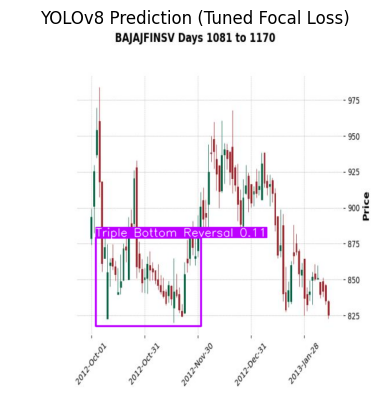

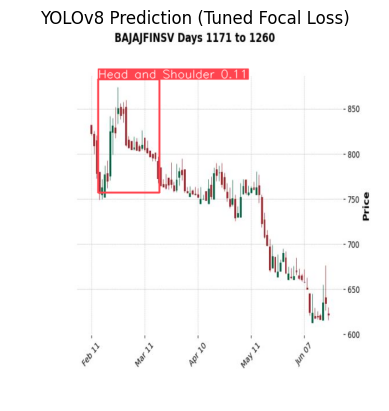

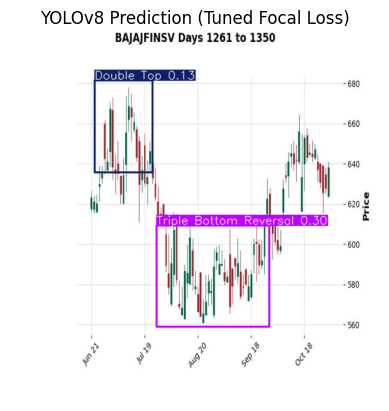

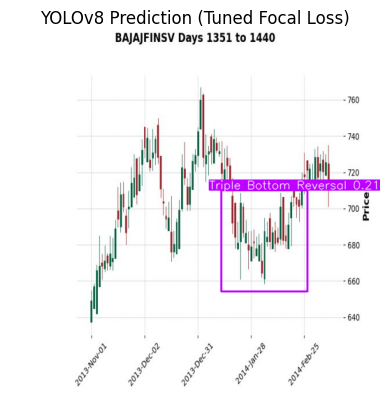

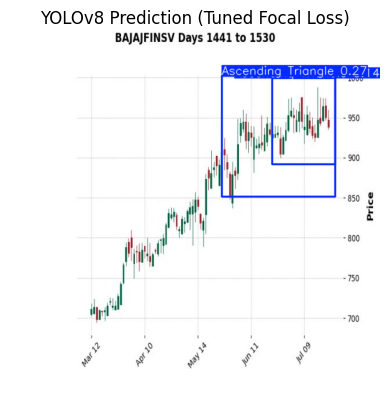

...

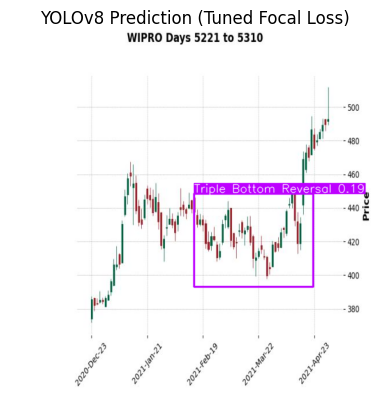

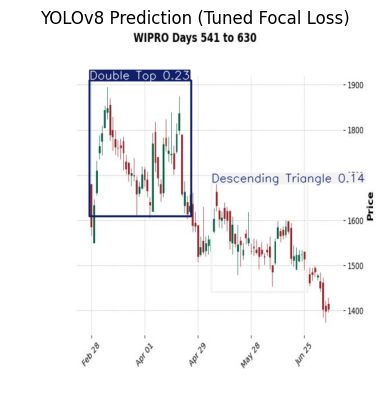

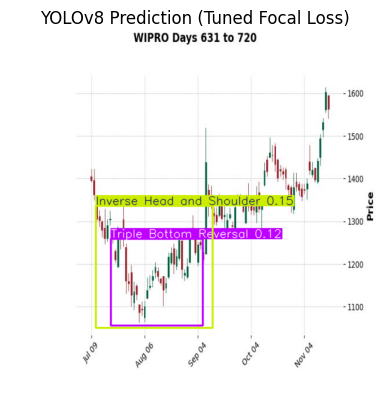

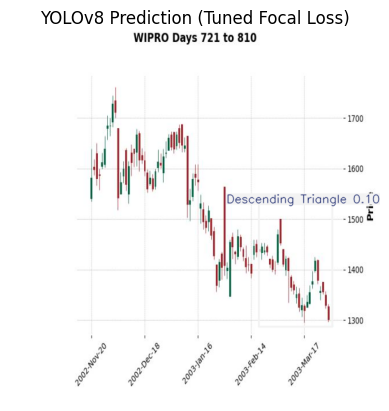

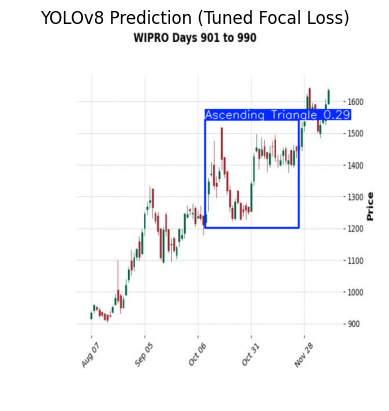

Predictions saved to runs/detect/predict


In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO
import torch
import torch.nn as nn
from ultralytics.utils.loss import v8DetectionLoss
from huggingface_hub import hf_hub_download

# Custom Focal Loss Implementation
class CustomFocalLoss(nn.Module):
    def __init__(self, gamma=2.0, alpha=0.25, reduction='mean'):
        super().__init__()
        self.gamma = gamma
        self.alpha = alpha
        self.reduction = reduction
        self.bce = nn.BCEWithLogitsLoss(reduction='none')

    def forward(self, pred, target):
        bce_loss = self.bce(pred, target)
        p_t = torch.exp(-bce_loss)
        focal_loss = self.alpha * (1 - p_t) ** self.gamma * bce_loss
        if self.reduction == 'mean':
            return focal_loss.mean()
        elif self.reduction == 'sum':
            return focal_loss.sum()
        return focal_loss

# Custom Loss Class with Tunable Focal Loss
class Customv8DetectionLoss(v8DetectionLoss):
    def __init__(self, model, gamma=2.0, alpha=0.25):
        # Pass the underlying PyTorch model, not the YOLO wrapper
        super().__init__(model.model)  # Use model.model instead of model
        self.cls_loss_fn = CustomFocalLoss(gamma=gamma, alpha=alpha, reduction='mean')

    def __call__(self, preds, batch):
        return super().__call__(preds, batch)

# Load Pre-trained Model
def load_huggingface_model(repo_id="foduucom/stockmarket-pattern-detection-yolov8", filename="best.pt"):
    try:
        model_path = hf_hub_download(repo_id=repo_id, filename=filename)
        print(f"Pre-trained model downloaded to: {model_path}")
        model = YOLO(model_path)
        return model
    except Exception as e:
        print(f"Error downloading or loading model from Hugging Face: {e}")
        print("Falling back to default YOLOv8m model.")
        model = YOLO("yolov8m.pt")
        return model

# Train with Tunable Focal Loss
def train_yolov8(data_yaml, model_save_path, epochs=150, img_size=640, gamma=2.0, alpha=0.25, dfl=1.5, box=7.5):
    model = load_huggingface_model()
    if model is None:
        print("Failed to load pre-trained model. Exiting.")
        return None

    # Apply custom loss with tunable gamma and alpha
    model.model.loss = Customv8DetectionLoss(model, gamma=gamma, alpha=alpha)  # Set loss on the underlying model


    try:
        model.train(
            data=data_yaml,
            epochs=epochs,
            imgsz=img_size,
            device="cuda" if torch.cuda.is_available() else "cpu",
            batch=16,
            workers=4,
            project="runs/train",
            name="exp_transfer_learning_focal_tuned",
            lr0=0.01,
            lrf=0.1,
            patience=0,
            dfl=dfl,
            box=box,
            cls=1.0,

        )
        model.save(model_save_path)
        print(f"Model saved to {model_save_path}")
        return model
    except Exception as e:
        print(f"Error during training: {e}")
        return None

# Inference
def predict_yolov8(model_path, val_images_dir, output_dir="runs/detect/predict", conf=0.1, iou=0.45):
    if not os.path.exists(val_images_dir) or not os.listdir(val_images_dir):
        print(f"Error: Validation images directory '{val_images_dir}' is empty or does not exist.")
        return None

    try:
        model = YOLO(model_path)
    except Exception as e:
        print(f"Error loading YOLOv8 model: {e}")
        return None

    try:
        results = model.predict(
            source=val_images_dir,
            conf=conf,
            iou=iou,
            save=True,
            save_txt=True,
            project=output_dir,
            name="exp"
        )
        for result in results:
            annotated_image = result.plot()
            plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
            plt.axis("off")
            plt.title("YOLOv8 Prediction (Tuned Focal Loss)")
            plt.show()

        print(f"Predictions saved to {output_dir}")
        return results
    except Exception as e:
        print(f"Error during prediction: {e}")
        return None

# Pipeline
def run_yolov8_pipeline(dataset_dir="dataset", model_save_path="yolov8_trained_transfer_learning-2.pt"):
    data_yaml = os.path.join(dataset_dir, "data.yaml")
    if not os.path.exists(data_yaml):
        print(f"Error: data.yaml not found in {dataset_dir}")
        return

    trained_model = train_yolov8(data_yaml, model_save_path, epochs=150, img_size=640, gamma=2.0, alpha=0.25, dfl=1.5, box=7.5)
    val_images_dir = os.path.join(dataset_dir, "valid", "images")
    if os.path.exists(val_images_dir) and trained_model:
        predict_yolov8(model_save_path, val_images_dir, conf=0.1, iou=0.45)
    else:
        print("Validation images directory not found or training failed.")

# Run
if __name__ == "__main__":
    try:
        import huggingface_hub
    except ImportError:
        os.system("pip install huggingface_hub")


    dataset_dir = "/content/drive/MyDrive/dataset_yolo"
    model_save_path = "/content/drive/MyDrive/yolov8_trained_transfer_learning-2.pt"
    run_yolov8_pipeline(dataset_dir, model_save_path)

Using existing predictions in runs/detect/predict/exp/labels


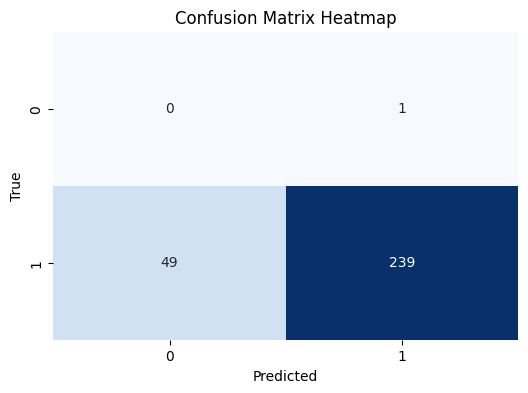

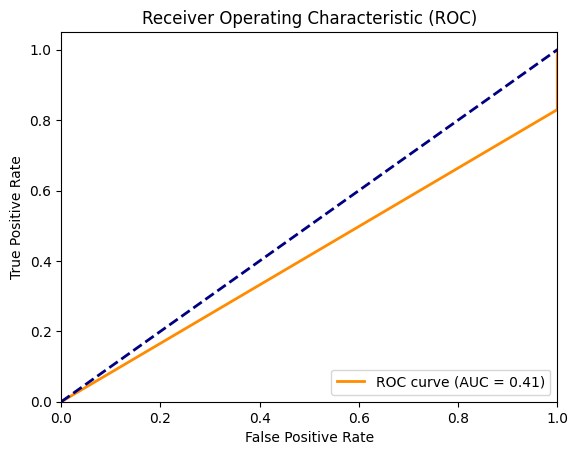

Metrics: {'accuracy': 0.8269896193771626, 'precision': 0.9958333333333333, 'recall': 0.8298611111111112, 'f1_score': 0.9053030303030303, 'auc': np.float64(0.4149305555555556)}


In [ ]:
import os
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns
from ultralytics import YOLO

# Paths from your setup
MODEL_PATH = "/content/drive/MyDrive/yolov8_trained_transfer_learning-2.pt"
VAL_IMAGES_DIR = "/content/drive/MyDrive/dataset_yolo/valid/images"
VAL_LABELS_DIR = "/content/drive/MyDrive/dataset_yolo/valid/labels"
PRED_DIR = "runs/detect/predict/exp/labels"  # Default prediction output from your original code

def generate_predictions_if_needed(model_path, val_images_dir, pred_dir, conf=0.5, iou=0.45):
    """
    Generate predictions if they don’t already exist.
    """
    if not os.path.exists(pred_dir) or not os.listdir(pred_dir):
        print(f"Prediction directory '{pred_dir}' is empty or does not exist. Generating predictions...")
        model = YOLO(model_path)
        model.predict(
            source=val_images_dir,
            conf=conf,
            iou=iou,
            save=True,
            save_txt=True,
            project="runs/detect/predict",
            name="exp"
        )
        print(f"Predictions saved to {pred_dir}")
    else:
        print(f"Using existing predictions in {pred_dir}")

def calculate_metrics(pred_dir, val_labels_dir):
    """
    Calculate evaluation metrics based on YOLOv8 predictions and ground truth labels.

    Args:
        pred_dir (str): Directory with prediction .txt files.
        val_labels_dir (str): Directory with ground truth .txt files.

    Returns:
        dict: Calculated metrics.
    """
    # Ensure predictions exist
    generate_predictions_if_needed(MODEL_PATH, VAL_IMAGES_DIR, pred_dir)

    # Lists to store ground truth and predictions
    y_true = []  # Ground truth labels (0: no object, 1: object)
    y_pred = []  # Predicted labels (0: no object, 1: object)
    y_scores = []  # Confidence scores for ROC/AUC

    # Get all ground truth files
    gt_files = {f.split(".txt")[0] for f in os.listdir(val_labels_dir) if f.endswith(".txt")}
    pred_files = {f.split(".txt")[0] for f in os.listdir(pred_dir) if f.endswith(".txt")} if os.path.exists(pred_dir) else set()

    # Process each validation image
    for img_name in gt_files:
        gt_path = os.path.join(val_labels_dir, f"{img_name}.txt")
        pred_path = os.path.join(pred_dir, f"{img_name}.txt") if img_name in pred_files else None

        # Ground truth: 1 if any object exists, 0 if none
        with open(gt_path, "r") as f:
            gt_lines = f.readlines()
            y_true.append(1 if len(gt_lines) > 0 else 0)

        # Prediction: 1 if any object detected, 0 if none
        if pred_path and os.path.exists(pred_path):
            with open(pred_path, "r") as f:
                pred_lines = f.readlines()
                if len(pred_lines) > 0:
                    y_pred.append(1)
                    # Use the highest confidence score for ROC
                    scores = [float(line.split()[5]) for line in pred_lines if len(line.split()) > 5]
                    y_scores.append(max(scores) if scores else 0.5)  # Default conf if no score
                else:
                    y_pred.append(0)
                    y_scores.append(0.0)
        else:
            y_pred.append(0)
            y_scores.append(0.0)

    # Ensure lengths match
    if len(y_true) != len(y_pred):
        print(f"Warning: Mismatch between ground truth ({len(y_true)}) and predictions ({len(y_pred)}). Truncating.")
        min_len = min(len(y_true), len(y_pred))
        y_true = y_true[:min_len]
        y_pred = y_pred[:min_len]
        y_scores = y_scores[:min_len]

    # Calculate metrics
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)

    # Confusion Matrix and Heatmap
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False)
    plt.title("Confusion Matrix Heatmap")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()

    # ROC and AUC
    fpr, tpr, _ = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)
    plt.figure()
    plt.plot(fpr, tpr, color="darkorange", lw=2, label=f"ROC curve (AUC = {roc_auc:.2f})")
    plt.plot([0, 1], [0, 1], color="navy", lw=2, linestyle="--")
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("Receiver Operating Characteristic (ROC)")
    plt.legend(loc="lower right")
    plt.show()

    # Compile metrics
    metrics = {
        "accuracy": accuracy,
        "precision": precision,
        "recall": recall,
        "f1_score": f1,
        "auc": roc_auc
    }
    print(f"Metrics: {metrics}")
    return metrics

# Run the metrics calculation
if __name__ == "__main__":
    if not os.path.exists(VAL_LABELS_DIR):
        print(f"Error: Validation labels directory '{VAL_LABELS_DIR}' not found.")
    elif not os.path.exists(MODEL_PATH):
        print(f"Error: Model file '{MODEL_PATH}' not found.")
    else:
        calculate_metrics(PRED_DIR, VAL_LABELS_DIR)

from sklearn.metrics import classification_report, confusion_matrix

def get_multiclass_metrics(pred_dir, val_labels_dir, class_names):
    """
    Compute per-class confusion matrix and classification report.
    Assumes YOLO format: class_id x_center y_center width height [conf]
    """
    generate_predictions_if_needed(MODEL_PATH, VAL_IMAGES_DIR, pred_dir)

    y_true = []
    y_pred = []

    gt_files = {f.split(".txt")[0] for f in os.listdir(val_labels_dir) if f.endswith(".txt")}
    pred_files = {f.split(".txt")[0] for f in os.listdir(pred_dir) if f.endswith(".txt")}

    for img_name in gt_files:
        gt_path = os.path.join(val_labels_dir, f"{img_name}.txt")
        pred_path = os.path.join(pred_dir, f"{img_name}.txt")

        # Extract ground truth labels
        gt_labels = []
        if os.path.exists(gt_path):
            with open(gt_path, "r") as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) >= 1:
                        gt_labels.append(int(parts[0]))

        # Extract predicted labels
        pred_labels = []
        if os.path.exists(pred_path):
            with open(pred_path, "r") as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) >= 1:
                        pred_labels.append(int(parts[0]))

        # Compare predictions and ground truths (match number of predictions to GTs)
        y_true.extend(gt_labels)
        y_pred.extend(pred_labels if pred_labels else [-1] * len(gt_labels))  # -1 for missed predictions

    # Filter out invalid predictions
    valid_classes = list(range(len(class_names)))
    y_true_filtered = [yt for yt in y_true if yt in valid_classes]
    y_pred_filtered = [yp if yp in valid_classes else -1 for yp in y_pred[:len(y_true_filtered)]]

    # Classification report and confusion matrix
    print("\nClassification Report (Per Class):\n")
    print(classification_report(y_true_filtered, y_pred_filtered, target_names=class_names, digits=3, zero_division=0))

    cm = confusion_matrix(y_true_filtered, y_pred_filtered, labels=valid_classes)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.title("Confusion Matrix (Per Class)")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

Using existing predictions in runs/detect/predict/exp/labels

Classification Report (Per Class):

                           precision    recall  f1-score   support

       Ascending Triangle      0.000     0.000     0.000         0
           Cup and Handle      0.286     0.147     0.194        68
      Descending Triangle      0.000     0.000     0.000         6
            Double Bottom      0.222     0.129     0.163        31
               Double Top      0.000     0.000     0.000        12
        Head and Shoulder      0.098     0.174     0.125        23
Inverse Head and Shoulder      0.103     0.235     0.143        17
       Symmetric Triangle      0.143     0.143     0.143        14
            Falling wedge      0.091     0.057     0.070        35
   Triple Bottom Reversal      0.318     0.351     0.333        77
            Flag-and-Pole      0.000     0.000     0.000         5

                 accuracy                          0.184       288
                macro avg    

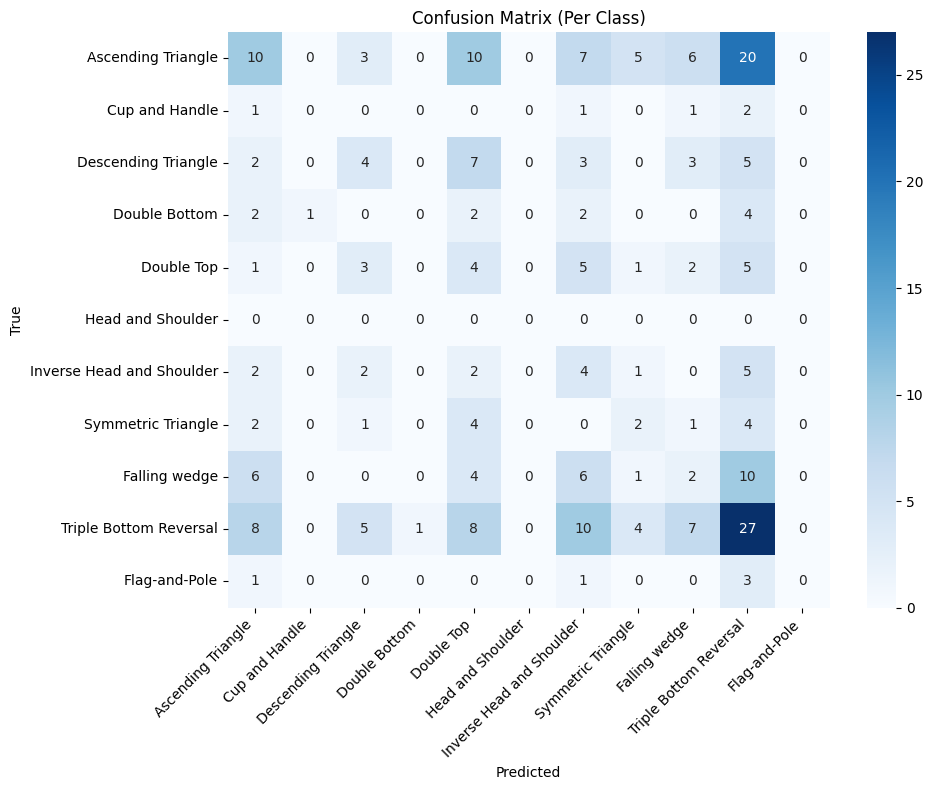

In [ ]:
class_names = [
    "Ascending Triangle",
    "Cup and Handle",
    "Descending Triangle",
    "Double Bottom",
    "Double Top",
    "Head and Shoulder",
    "Inverse Head and Shoulder",
    "Symmetric Triangle",
    "Falling wedge",
    "Triple Bottom Reversal",
    "Flag-and-Pole"
]

get_multiclass_metrics(pred_dir="runs/detect/predict/exp/labels",
                       val_labels_dir="/content/drive/MyDrive/dataset_yolo/valid/labels",
                       class_names=class_names)